In [1]:
import sys
import os
import numpy as np
import pandas as pd

sys.path.append(os.path.abspath('../..'))

from offshore_wind_nj.config import JERSEY_ATLANTIC_DATA_DIR, FIGURES_DIR
import matplotlib.pyplot as plt
from pyproj import Proj, Transformer
from sklearn.preprocessing import StandardScaler, MinMaxScaler

2025-04-05 13:47:53.324 | INFO     | offshore_wind_nj.config:<module>:11 - PROJ_ROOT path is: /nfs/storage1/home/noriegac/Documents/Offshore_Wind_Research


# Load the dataset

In [2]:
jersy_atlantic_path = JERSEY_ATLANTIC_DATA_DIR / 'JAW_Wind_Data.xlsx'
df = pd.read_excel(jersy_atlantic_path)

# Data Cleaning

In [3]:
df['u_vector'] = np.sin(np.radians(df['WindDirection']))
df['v_vector'] = np.cos(np.radians(df['WindDirection']))

In [4]:
df.fillna({'PowerkW':-10}, inplace=True)

In [5]:
df.loc[df[df['PowerkW']<=0].index, 'PowerkW'] = 0

In [6]:
# Identify timestamps where ALL turbines have missing WindSpeed data
timestamps_all_missing = df.groupby('StampTime')['WindSpeed'].apply(lambda x: x.isna().all())

# Get a list of these timestamps
timestamps_to_drop = timestamps_all_missing[timestamps_all_missing].index

# Drop rows with these timestamps
df = df[~df['StampTime'].isin(timestamps_to_drop)].reset_index(drop=True)


In [7]:
df[df['StampTime'].isin(timestamps_all_missing[timestamps_all_missing].index)]

,Turbine,StampTime,WindSpeed,WindDirection,PowerkW,u_vector,v_vector


In [8]:
for column in ['WindSpeed', 'u_vector', 'v_vector']:
    df[column] = df.groupby('StampTime')[column]\
                                    .transform(lambda x: x.fillna(x.mean()))

In [9]:
# Compute wind direction from u and v components
def compute_wind_direction(u, v):
    wind_direction = (np.degrees(np.arctan2(u, v)) + 360) % 360
    return wind_direction

# Example usage:
df['WindDirection'] = compute_wind_direction(df['u_vector'], df['v_vector'])

In [10]:
df["WindSpeed_Squared"] = df["WindSpeed"] ** 2
df["WindSpeed_Cubic"] = df["WindSpeed"] ** 3

In [11]:
df['u_vector_cubic'] = np.sin(np.radians(df['WindDirection'])) * df['WindSpeed_Cubic']
df['v_vector_cubic'] = np.cos(np.radians(df['WindDirection'])) * df['WindSpeed_Cubic']

# Turbines coordinates

In [12]:
turbines = [
    {"Turbine": "T01", "latitude": 39.3839, "longitude": -74.4485},
    {"Turbine": "T02", "latitude": 39.3822, "longitude": -74.4504},
    {"Turbine": "T03", "latitude": 39.3801, "longitude": -74.4497},
    {"Turbine": "T04", "latitude": 39.3825, "longitude": -74.4454},
    {"Turbine": "T05", "latitude": 39.3811, "longitude": -74.4477}
]

turbines_df = pd.DataFrame(turbines)


In [13]:
df = pd.merge(df, turbines_df, on='Turbine', how='left')


# GNN Tuturial AAAI 2025

## 📡 Graph Neural Network for Wind Farm Energy Modeling

We model the wind farm as a graph where:

- **Nodes** represent individual wind turbines.
- **Edges** represent potential influence between turbines (e.g., due to wake effects).
- **Node features** describe each turbine's state at a given timestamp, including wind conditions and location.
- **Target labels** are the actual energy output (`PowerkW`) produced by each turbine.

---

### 🔢 Node Feature Vector

Each turbine $i$ is represented by a feature vector:

$$
\mathbf{x}_i = [u_i, v_i, \text{lat}_i, \text{lon}_i]
$$

Where:

- $u_i$, $v_i$ are wind vector components (cubic-adjusted)
- $\text{lat}_i$, $\text{lon}_i$ are standardized spatial coordinates

---

### 🎯 Prediction Objective

We want to predict the energy output $y_i$ for each turbine $i$ using a GNN that learns from both:

- The turbine's own features $\mathbf{x}_i$
- The wind-structured relationships to other turbines in the graph

The prediction is:

$$
\hat{y}_i = \Phi(\mathbf{x}_i; \mathcal{G})
$$

Where:

- $\Phi$ is the GNN function
- $\mathcal{G}$ is the graph constructed using turbine layout and wind direction

---

### 🔗 Graph Structure

Edges $\mathcal{E}$ in the graph are defined by:

- **Proximity**: Turbines close to each other are more likely to interact
- **Wind Directionality**: Edges are directed from upstream to downstream turbines
- **Wake Likelihood**: Optional edge weights can model wake strength based on wind alignment

---

### 🧠 Learning Task

We train the GNN using supervised learning with Mean Squared Error (MSE) loss:

$$
\mathcal{L}(y, \hat{y}) = \frac{1}{2} \sum_i (y_i - \hat{y}_i)^2
$$

The GNN learns how wind patterns correlate across turbines and how they affect energy production over time.


# 📘 Static Graph GNN Training Log (Wake-Aware)

## ✅ Objective
Develop a Graph Neural Network (GNN) model that captures directional relationships among wind turbines to understand and predict wake effects, using historical wind direction and energy output data.

---

## 🧭 Step-by-Step Summary

### 1. **Understand the Data Structure**
- Each row represents a turbine's measurements at a specific timestamp.
- Key columns:
  - `u_vector_cubic`, `v_vector_cubic` (wind vectors)
  - `latitude`, `longitude` (location)
  - `WindDirection` (azimuth in degrees FROM which wind is coming)
  - `PowerkW` (energy output, our prediction target)

---

### 2. **Define Graph Logic**
- Each turbine = 1 **node** in a graph.
- Each timestamp = 1 **graph**.
- Edge creation logic:
  - For each turbine `i`, compute **wind flow direction**: `(WindDirection_i + 180) % 360`
  - For each other turbine `j`, compute **angle from `i → j`**
  - If the angular difference is within a **45° threshold**, create edge `i → j` (indicating wake influence)

---

### 3. **Feature Preprocessing**
For each timestamp:
- Standardize: `u_vector_cubic`, `v_vector_cubic`, `latitude`, `longitude`
- Normalize: `PowerkW` using MinMaxScaler

---

### 4. **Graph Construction**
- For each timestamp, build a `torch_geometric.data.Data` object:
  - `x`: node features = `[u, v, lat, lon]`
  - `edge_index`: dynamically computed using wind-aligned edge logic
  - `y`: labels = normalized `PowerkW`
- Append each graph to a list (`graph_list`) for training

---

### 5. **GNN Architecture**
```python
class TurbineGNN(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim=1):
        super(TurbineGNN, self).__init__()
        self.conv1 = GCNConv(input_dim, hidden_dim)
        self.conv2 = GCNConv(hidden_dim, output_dim)

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x = self.conv1(x, edge_index)
        x = torch.relu(x)
        x = self.conv2(x, edge_index)
        return x
```

---

### 6. **Training Setup**
- Device: GPU if available
- Optimizer: Adam
- Loss: MSE between predicted and actual `PowerkW`
- Trained for 100 epochs with logging every 10 epochs

---

### ✅ Next Steps
- Evaluate predictions on **unseen timestamps**
- Visualize **node embeddings** and compare directional influence
- Analyze **wake effects** under varying wind conditions

---

### 🧠 Key Takeaway
By modeling turbine wake effects using directed graphs informed by real wind direction data, we can train a GNN that learns to predict energy output in a physically meaningful way.

---

*End of training log.*



In [14]:
import torch
from torch_geometric.data import Data
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import numpy as np

from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder
import torch
from torch_geometric.data import Data
import numpy as np

In [15]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder
from geopy.distance import geodesic
import torch
from torch_geometric.data import Data
import numpy as np

def create_static_edge_index_and_weights(turbine_ids, turbine_coords):
    edge_index = []
    edge_attr = []

    for i, t1 in enumerate(turbine_ids):
        for j, t2 in enumerate(turbine_ids):
            if i != j:
                coord1 = (turbine_coords[t1]['latitude'], turbine_coords[t1]['longitude'])
                coord2 = (turbine_coords[t2]['latitude'], turbine_coords[t2]['longitude'])
                dist = geodesic(coord1, coord2).meters
                edge_index.append([i, j])
                edge_attr.append([1 / dist])  # inverse distance

    edge_index_tensor = torch.tensor(edge_index, dtype=torch.long).t().contiguous()
    edge_attr_tensor = torch.tensor(edge_attr, dtype=torch.float)
    return edge_index_tensor, edge_attr_tensor

def create_static_graphs_from_df(df):
    graph_list = []

    df_scaled = df.copy()

    # Scale wind vectors
    scaler_vectors = StandardScaler()
    df_scaled[['WindSpeed','u_vector', 'v_vector']] = scaler_vectors.fit_transform(
        df_scaled[['WindSpeed','u_vector', 'v_vector']]
    )

    # Scale coordinates
    scaler_coords = StandardScaler()
    df_scaled[['latitude', 'longitude']] = scaler_coords.fit_transform(
        df_scaled[['latitude', 'longitude']]
    )

    # Normalize power
    scaler_power = MinMaxScaler()
    df_scaled['PowerkW'] = scaler_power.fit_transform(df_scaled[['PowerkW']])

    # One-hot encode turbine IDs
    turbine_ids = df_scaled['Turbine'].unique().tolist()
    enc = OneHotEncoder(sparse_output=False, handle_unknown='ignore')
    one_hot = enc.fit_transform(np.array(turbine_ids).reshape(-1, 1))
    turbine_onehot_map = {tid: one_hot[i] for i, tid in enumerate(turbine_ids)}

    # Get raw (unscaled) coordinates for edge weights
    raw_coords = df.groupby("Turbine")[["latitude", "longitude"]].first().to_dict("index")
    edge_index, edge_attr = create_static_edge_index_and_weights(turbine_ids, raw_coords)

    for timestamp in df_scaled['StampTime'].unique():
        snapshot_df = df_scaled[df_scaled['StampTime'] == timestamp].copy()
        snapshot_df = snapshot_df.set_index('Turbine').reindex(turbine_ids).reset_index()

        if snapshot_df.isnull().values.any():
            continue

        # Combine features + one-hot encoding
        turbine_onehots = np.array([turbine_onehot_map[tid] for tid in snapshot_df['Turbine']])
        x_feats = snapshot_df[['WindSpeed','u_vector', 'v_vector', 'latitude', 'longitude']].values
        x_all = np.hstack((x_feats, turbine_onehots))

        x = torch.tensor(x_all, dtype=torch.float)
        y = torch.tensor(snapshot_df['PowerkW'].values, dtype=torch.float)

        # Include turbine_id for downstream embedding visualization
        turbine_indices = np.array([turbine_ids.index(tid) for tid in snapshot_df['Turbine']])
        turbine_id_tensor = torch.tensor(turbine_indices, dtype=torch.long)

        graph_data = Data(x=x, edge_index=edge_index, edge_attr=edge_attr, y=y)
        graph_data.turbine_id = turbine_id_tensor

        graph_list.append(graph_data)

    return graph_list


In [16]:
graph_list = create_static_graphs_from_df(df)

In [17]:
# 1. Create static graphs
# graph_list = create_static_graphs_from_df(df)
print(f"✅ Created {len(graph_list)} graphs from timestamps")

✅ Created 43301 graphs from timestamps


In [18]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch_geometric.nn import GCNConv
from torch_geometric.loader import DataLoader
from sklearn.model_selection import train_test_split

# 2. Train/test split (80/20)
train_graphs, test_graphs = train_test_split(graph_list, test_size=0.2, shuffle=True, random_state=42)
train_loader = DataLoader(train_graphs, batch_size=8, shuffle=True)
test_loader = DataLoader(test_graphs, batch_size=8, shuffle=False)

In [19]:
train_loader

In [20]:
class TurbineGNN(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim=1):
        super(TurbineGNN, self).__init__()
        self.conv1 = GCNConv(input_dim, hidden_dim)
        self.conv2 = GCNConv(hidden_dim, output_dim)
        self.dropout = nn.Dropout(p=0.2)

    def forward(self, data, return_embedding=False):
        x, edge_index = data.x, data.edge_index
        x = self.conv1(x, edge_index)
        x = torch.relu(x)
        x = self.dropout(x)

        if return_embedding:
            return x  # 💡 Return embedding before final output
        x = self.conv2(x, edge_index)
        return x


# 4. Model setup
input_dim = 5 + 5 # u, v, lat, lon
hidden_dim = 64
output_dim = 1

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = TurbineGNN(input_dim, hidden_dim, output_dim).to(device)
optimizer = optim.Adam(model.parameters(), lr=0.01)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=30, gamma=0.5)

# 5. Training loop
model.train()
for epoch in range(1, 101):
    total_loss = 0
    for batch in train_loader:
        batch = batch.to(device)
        optimizer.zero_grad()
        output = model(batch)
        target = batch.y.unsqueeze(1)
        loss = nn.functional.mse_loss(output, target)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
    scheduler.step()
    if epoch % 10 == 0:
        print(f"Epoch {epoch}, Train Loss: {total_loss / len(train_loader):.4f}")


Epoch 10, Train Loss: 0.0179
Epoch 20, Train Loss: 0.0179
Epoch 30, Train Loss: 0.0179
Epoch 40, Train Loss: 0.0171
Epoch 50, Train Loss: 0.0171
Epoch 60, Train Loss: 0.0172
Epoch 70, Train Loss: 0.0167
Epoch 80, Train Loss: 0.0167
Epoch 90, Train Loss: 0.0167
Epoch 100, Train Loss: 0.0165


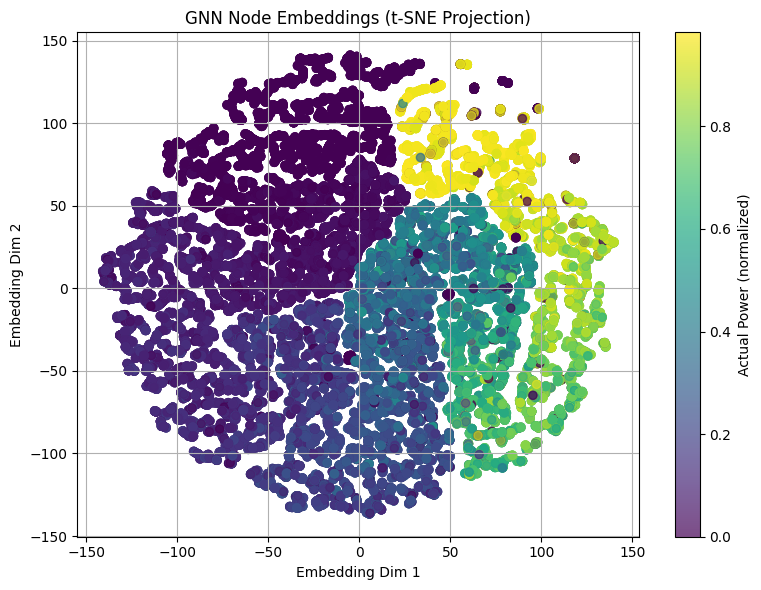

In [21]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# 1. Collect embeddings from test set
embeddings = []
labels = []  # Optional: turbine index or actual power

model.eval()
with torch.no_grad():
    for batch in test_loader:
        batch = batch.to(device)
        node_embed = model(batch, return_embedding=True)
        embeddings.append(node_embed.cpu().numpy())
        labels.extend(batch.y.cpu().numpy())  # or use turbine index

embeddings = np.vstack(embeddings)

# 2. Reduce dimensionality (use t-SNE)
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
emb_2d = tsne.fit_transform(embeddings)

# 3. Plot the embeddings
plt.figure(figsize=(8, 6))
sc = plt.scatter(emb_2d[:, 0], emb_2d[:, 1], c=labels, cmap='viridis', alpha=0.7)
plt.colorbar(sc, label='Actual Power (normalized)')
plt.title("GNN Node Embeddings (t-SNE Projection)")
plt.xlabel("Embedding Dim 1")
plt.ylabel("Embedding Dim 2")
plt.grid(True)
plt.tight_layout()
plt.show()

In [22]:
torch.no_grad()

🧪 Unique Turbine IDs: [0 1 2 3 4]
🔢 Counts per ID: [8661 8661 8661 8661 8661]


/tmp/ipykernel_59540/1377012488.py:45: UserWarning: Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/home/noriegac/.conda/envs/cris_env/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 129504 (\N{BRAIN}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


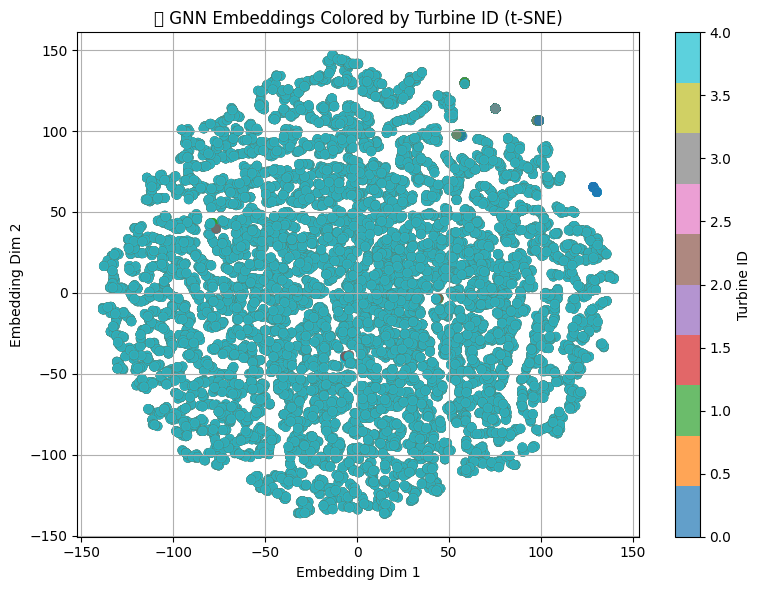

In [23]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.manifold import TSNE

# Containers for embeddings and turbine IDs
embeddings = []
turbine_ids = []

model.eval()
with torch.no_grad():
    for batch in test_loader:
        batch = batch.to(device)

        # Extract node embeddings BEFORE final prediction layer
        node_embed = model(batch, return_embedding=True)
        embeddings.append(node_embed.cpu().numpy())

        # Collect turbine ID if it exists in the graph
        if hasattr(batch, "turbine_id"):
            turbine_ids.append(batch.turbine_id.cpu().numpy())
        else:
            raise ValueError("❌ Missing turbine_id attribute in batch.")

# Flatten all embeddings and turbine IDs
embeddings = np.vstack(embeddings)
turbine_ids = np.concatenate(turbine_ids)

# ✅ DEBUG: Print turbine ID distribution
unique_ids, counts = np.unique(turbine_ids, return_counts=True)
print("🧪 Unique Turbine IDs:", unique_ids)
print("🔢 Counts per ID:", counts)

# t-SNE dimensionality reduction
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
emb_2d = tsne.fit_transform(embeddings)

# Plot
plt.figure(figsize=(8, 6))
scatter = plt.scatter(emb_2d[:, 0], emb_2d[:, 1], c=turbine_ids, cmap='tab10', alpha=0.7)
plt.colorbar(scatter, label="Turbine ID")
plt.title("🧠 GNN Embeddings Colored by Turbine ID (t-SNE)")
plt.xlabel("Embedding Dim 1")
plt.ylabel("Embedding Dim 2")
plt.grid(True)
plt.tight_layout()
plt.show()


Any NaNs in tsne_df? False


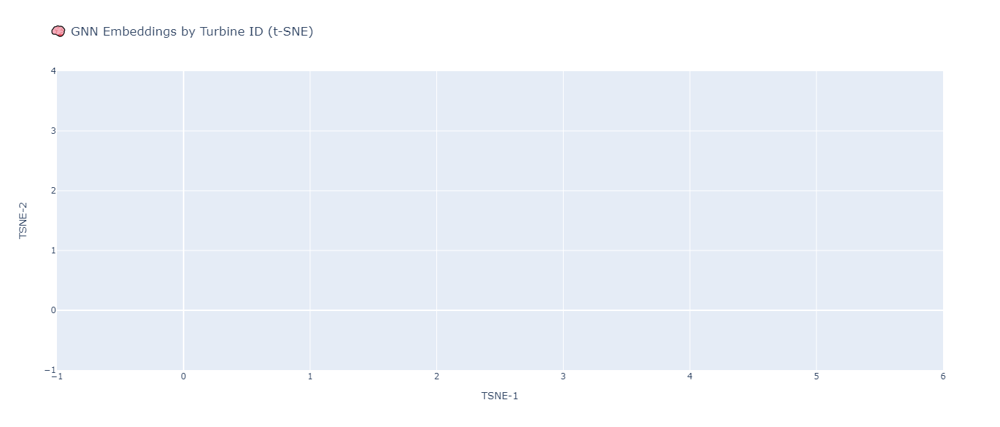

In [24]:
import pandas as pd
import plotly.express as px

# Rebuild the DataFrame cleanly
tsne_df = pd.DataFrame({
    "TSNE-1": emb_2d[:, 0],
    "TSNE-2": emb_2d[:, 1],
    "TurbineID": turbine_ids.astype(str)  # 👈 Ensure categorical color
})

# Check if any rows have NaNs (just in case)
print("Any NaNs in tsne_df?", tsne_df.isnull().any().any())

# Plot interactively with toggleable legends
fig = px.scatter(
    tsne_df,
    x="TSNE-1",
    y="TSNE-2",
    color="TurbineID",
    title="🧠 GNN Embeddings by Turbine ID (t-SNE)",
    labels={"TurbineID": "Turbine"},
    hover_data=["TurbineID"]
)

fig.update_traces(marker=dict(size=5, opacity=0.7))
fig.update_layout(width=800, height=600)
fig.show()


In [25]:
import plotly.io as pio
pio.renderers.default = "notebook"

fig.show()


/tmp/ipykernel_59540/1355061531.py:27: UserWarning:

Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.

/home/noriegac/.conda/envs/cris_env/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning:

Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.



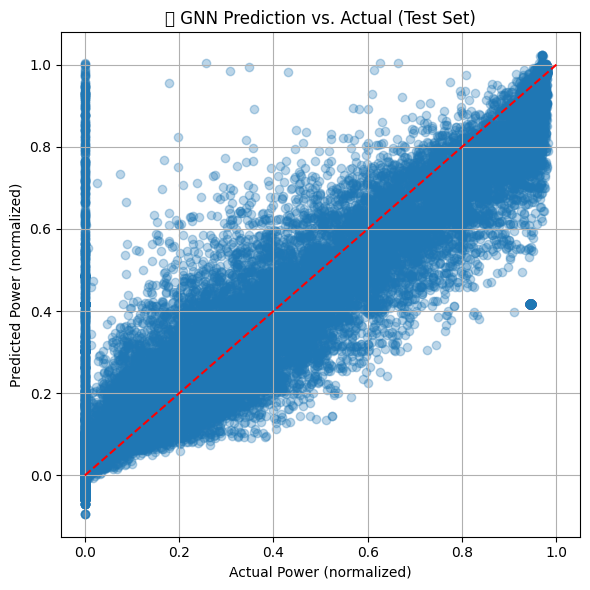

In [26]:
import matplotlib.pyplot as plt

# 1. Collect predictions and targets
all_preds = []
all_targets = []

model.eval()
with torch.no_grad():
    for batch in test_loader:
        batch = batch.to(device)
        output = model(batch)
        all_preds.append(output.cpu().numpy())
        all_targets.append(batch.y.unsqueeze(1).cpu().numpy())

# 2. Concatenate all predictions/targets
all_preds = np.vstack(all_preds)
all_targets = np.vstack(all_targets)

# 3. Plot
plt.figure(figsize=(6, 6))
plt.scatter(all_targets, all_preds, alpha=0.3)
plt.plot([0, 1], [0, 1], 'r--')  # Ideal 1:1 line
plt.xlabel("Actual Power (normalized)")
plt.ylabel("Predicted Power (normalized)")
plt.title("🔍 GNN Prediction vs. Actual (Test Set)")
plt.grid(True)
plt.tight_layout()
plt.show()


/tmp/ipykernel_59540/629810017.py:33: UserWarning:

Glyph 128201 (\N{CHART WITH DOWNWARDS TREND}) missing from font(s) DejaVu Sans.

/home/noriegac/.conda/envs/cris_env/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning:

Glyph 128201 (\N{CHART WITH DOWNWARDS TREND}) missing from font(s) DejaVu Sans.



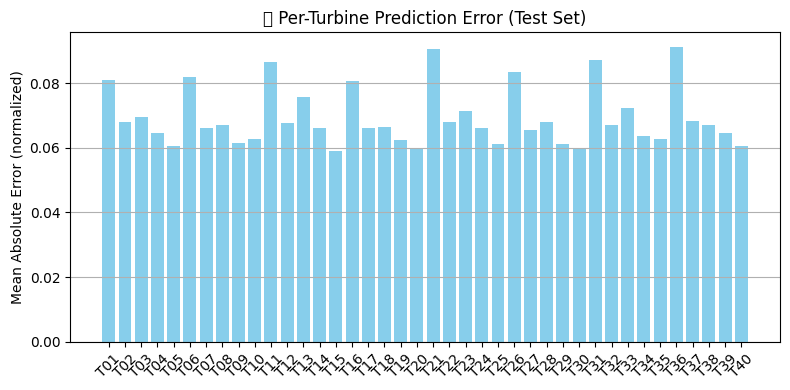

In [27]:
from collections import defaultdict
import numpy as np
import matplotlib.pyplot as plt

# 1. Create error buckets per turbine index
errors_per_turbine = defaultdict(list)

# 2. Collect errors by turbine position
with torch.no_grad():
    for batch in test_loader:
        batch = batch.to(device)
        output = model(batch)
        predictions = output.squeeze().cpu().numpy()
        targets = batch.y.cpu().numpy()

        for i in range(len(predictions)):
            turbine_idx = i % len(predictions)  # assumes fixed order
            error = abs(predictions[i] - targets[i])
            errors_per_turbine[turbine_idx].append(error)

# 3. Compute MAE per turbine
turbine_mae = {t: np.mean(errs) for t, errs in errors_per_turbine.items()}

# 4. Sort and plot
sorted_ids = sorted(turbine_mae.keys())
mae_values = [turbine_mae[t] for t in sorted_ids]

plt.figure(figsize=(8, 4))
plt.bar([f"T{t+1:02d}" for t in sorted_ids], mae_values, color='skyblue')
plt.ylabel("Mean Absolute Error (normalized)")
plt.title("📉 Per-Turbine Prediction Error (Test Set)")
plt.xticks(rotation=45)
plt.tight_layout()
plt.grid(True, axis='y')
plt.show()


# GCN+GRU Architecture (High-Level Flow)

In [28]:
def create_temporal_sequences(graph_list, seq_len=5):
    """
    Create sequences of graph snapshots for temporal modeling.
    Each sequence is of length `seq_len` to predict the next timestep.
    """
    sequences = []
    targets = []

    for i in range(len(graph_list) - seq_len):
        seq = graph_list[i:i + seq_len]
        target = graph_list[i + seq_len]  # predict power at next timestep
        sequences.append(seq)
        targets.append(target.y)  # ground truth power output

    return sequences, targets


In [29]:
from torch_geometric.nn import GCNConv
import torch.nn as nn
import torch

class TemporalGCNGRU(nn.Module):
    def __init__(self, in_channels, gcn_hidden, gru_hidden, out_channels):
        super().__init__()
        self.gcn = GCNConv(in_channels, gcn_hidden)
        self.gru = nn.GRU(gcn_hidden, gru_hidden, batch_first=True)
        self.mlp = nn.Linear(gru_hidden, out_channels)

    def forward(self, sequence):
        """
        sequence: list of graph snapshots (length seq_len)
        Each graph has attributes x, edge_index, edge_attr
        """
        gcn_outputs = []
        for graph in sequence:
            x = torch.relu(self.gcn(graph.x, graph.edge_index))
            gcn_outputs.append(x.unsqueeze(1))  # shape: [N, 1, gcn_hidden]

        gcn_seq = torch.cat(gcn_outputs, dim=1)  # shape: [N, seq_len, gcn_hidden]
        gru_out, _ = self.gru(gcn_seq)  # shape: [N, seq_len, gru_hidden]
        final_hidden = gru_out[:, -1, :]  # last step
        out = self.mlp(final_hidden)  # shape: [N, out_channels]
        return out


In [30]:
from torch.utils.data import DataLoader, TensorDataset, random_split

# Create sequences of length 5 (to predict timestep 6)
sequence_len = 5
sequences, targets = create_temporal_sequences(graph_list, seq_len=sequence_len)

# 80/20 split
split_idx = int(0.8 * len(sequences))
train_seq, test_seq = sequences[:split_idx], sequences[split_idx:]
train_tgt, test_tgt = targets[:split_idx], targets[split_idx:]


In [31]:
class TemporalGraphDataset(torch.utils.data.Dataset):
    def __init__(self, sequences, targets):
        self.sequences = sequences
        self.targets = targets

    def __len__(self):
        return len(self.sequences)

    def __getitem__(self, idx):
        return self.sequences[idx], self.targets[idx]


In [32]:
def custom_collate(batch):
    sequences, targets = zip(*batch)  # unzip list of tuples
    return list(sequences), list(targets)


In [33]:
train_dataset = TemporalGraphDataset(train_seq, train_tgt)
test_dataset = TemporalGraphDataset(test_seq, test_tgt)

train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True, collate_fn=custom_collate)
test_loader = DataLoader(test_dataset, batch_size=1, collate_fn=custom_collate)


# Use the below code to train by batches in case the above code doesnt' run

In [ ]:

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Define model
model = TemporalGCNGRU(
    in_channels=graph_list[0].x.size(1),  # includes one-hot + wind + coords
    gcn_hidden=32,
    gru_hidden=64,
    out_channels=1
).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
loss_fn = nn.MSELoss()

# Training loop
model.train()
for epoch in range(1, 101):
    total_loss = 0

    for batch in train_loader:
        # Unpack the batch
        sequences, targets = batch

        # Process batch size > 1
        for sequence, target in zip(sequences, targets):
            sequence = [g.to(device) for g in sequence]
            target = target.to(device).unsqueeze(1)

            optimizer.zero_grad()
            pred = model(sequence)
            loss = loss_fn(pred, target)
            loss.backward()
            optimizer.step()

            total_loss += loss.item()

    if epoch % 10 == 0:
        avg_loss = total_loss / len(train_loader.dataset)
        print(f"Epoch {epoch}, Train Loss: {avg_loss:.4f}")


Epoch 10, Train Loss: 0.0261
Epoch 20, Train Loss: 0.0236
Epoch 30, Train Loss: 0.0236
Epoch 40, Train Loss: 0.0235
Epoch 50, Train Loss: 0.0236
Epoch 60, Train Loss: 0.0235
Epoch 70, Train Loss: 0.0236
Epoch 80, Train Loss: 0.0236
Epoch 90, Train Loss: 0.0235


In [51]:
model.eval()
predictions = []
true_values = []

with torch.no_grad():
    for sequence, target in test_loader:
        sequence = [g.to(device) for g in sequence[0]]
        pred = model(sequence).cpu().numpy().flatten()
        true = target[0].cpu().numpy().flatten()

        predictions.extend(pred)
        true_values.extend(true)


# Saved the model :)

In [56]:
torch.save(model, "GCN_plus_GRU.pth")

/tmp/ipykernel_59540/1034003278.py:11: UserWarning:

Glyph 128302 (\N{CRYSTAL BALL}) missing from font(s) DejaVu Sans.

/home/noriegac/.conda/envs/cris_env/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning:

Glyph 128302 (\N{CRYSTAL BALL}) missing from font(s) DejaVu Sans.



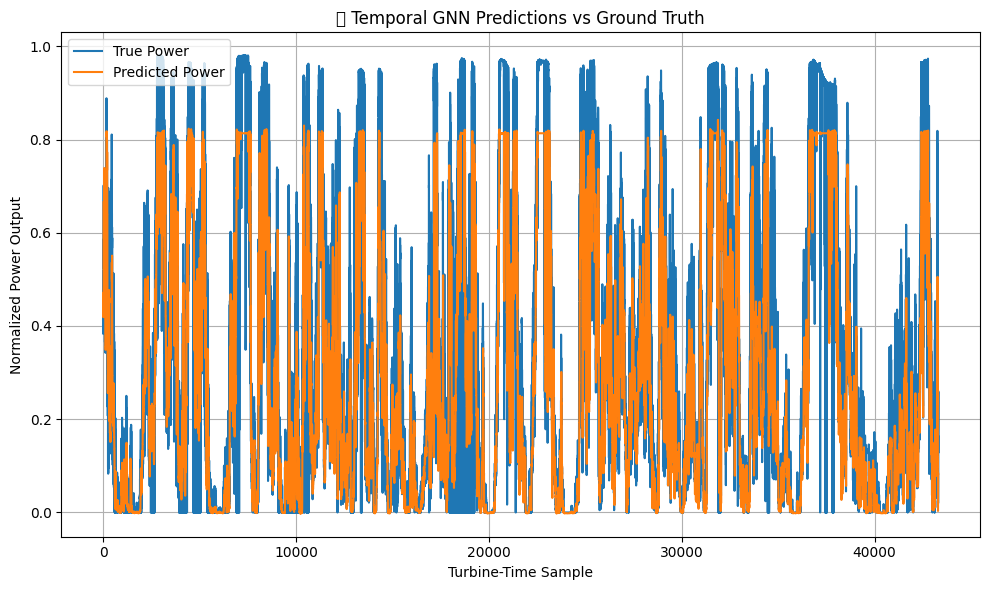

In [52]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(true_values, label='True Power')
plt.plot(predictions, label='Predicted Power')
plt.title("🔮 Temporal GNN Predictions vs Ground Truth")
plt.xlabel("Turbine-Time Sample")
plt.ylabel("Normalized Power Output")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [53]:
model.eval()

turbine_preds = {i: [] for i in range(graph_list[0].num_nodes)}
turbine_truth = {i: [] for i in range(graph_list[0].num_nodes)}

with torch.no_grad():
    for sequence, target in test_loader:
        sequence = [g.to(device) for g in sequence[0]]
        target = target[0].cpu().numpy()

        pred = model(sequence).cpu().numpy()

        for i in range(len(target)):
            turbine_preds[i].append(pred[i][0])
            turbine_truth[i].append(target[i])


/home/noriegac/.conda/envs/cris_env/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning:

Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.



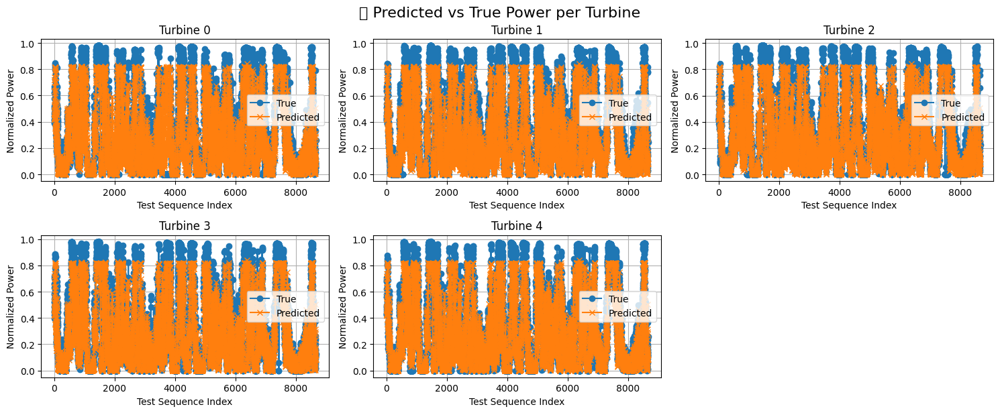

In [54]:
import matplotlib.pyplot as plt

num_turbines = len(turbine_preds)
cols = 3
rows = (num_turbines + cols - 1) // cols

plt.figure(figsize=(15, 3 * rows))

for tid in range(num_turbines):
    plt.subplot(rows, cols, tid + 1)
    plt.plot(turbine_truth[tid], label="True", marker='o')
    plt.plot(turbine_preds[tid], label="Predicted", marker='x')
    plt.title(f"Turbine {tid}")
    plt.xlabel("Test Sequence Index")
    plt.ylabel("Normalized Power")
    plt.grid(True)
    plt.legend()

plt.tight_layout()
plt.suptitle("🔍 Predicted vs True Power per Turbine", fontsize=16, y=1.02)
plt.show()


In [55]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

print("📊 Error Metrics Per Turbine:")
print("Turbine |     MAE     |    RMSE")
print("---------------------------------")

for tid in range(num_turbines):
    true_vals = np.array(turbine_truth[tid])
    pred_vals = np.array(turbine_preds[tid])

    mae = mean_absolute_error(true_vals, pred_vals)
    rmse = np.sqrt(mean_squared_error(true_vals, pred_vals))

    print(f"   {tid:2d}    |  {mae: .4f}  |  {rmse: .4f}")


📊 Error Metrics Per Turbine:
Turbine |     MAE     |    RMSE
---------------------------------
    0    |   0.1071  |   0.1620
    1    |   0.1032  |   0.1461
    2    |   0.0994  |   0.1463
    3    |   0.0772  |   0.1095
    4    |   0.0778  |   0.1164


# Step 1: GAT + GRU Model Definition

In [57]:
from torch_geometric.nn import GATConv
import torch.nn.functional as F

class TemporalGATGRU(nn.Module):
    def __init__(self, in_channels, gat_hidden, gru_hidden, out_channels=1, heads=1):
        super(TemporalGATGRU, self).__init__()
        self.gat = GATConv(in_channels, gat_hidden, heads=heads, concat=True)
        self.gru = nn.GRU(input_size=gat_hidden * heads, hidden_size=gru_hidden, batch_first=True)
        self.fc = nn.Linear(gru_hidden, out_channels)

    def forward(self, graph_sequence):
        all_embeddings = []

        # Step 1: GAT over each timestep graph
        for g in graph_sequence:
            x, edge_index = g.x, g.edge_index
            x = F.elu(self.gat(x, edge_index))  # 🧠 GAT with attention
            all_embeddings.append(x.unsqueeze(0))  # (1, num_nodes, features)

        # Step 2: Stack embeddings into (1, T, N, F) and rearrange to (N, T, F)
        node_features_seq = torch.cat(all_embeddings, dim=0)  # (T, N, F)
        node_features_seq = node_features_seq.transpose(0, 1)  # (N, T, F)

        # Step 3: GRU per node
        out, _ = self.gru(node_features_seq)  # (N, T, H)
        out = out[:, -1, :]  # Take last timestep (N, H)

        # Step 4: Linear to predict power
        return self.fc(out)  # (N, 1)


In [58]:
gat_model = TemporalGATGRU(
    in_channels=10,   # adjust based on your input features
    gat_hidden=32,
    gru_hidden=64,
    out_channels=1,
    heads=2
).to(device)

gat_optimizer = torch.optim.Adam(gat_model.parameters(), lr=0.01)
gat_scheduler = torch.optim.lr_scheduler.StepLR(gat_optimizer, step_size=30, gamma=0.5)


In [ ]:
gat_model.train()

for epoch in range(1, 101):
    total_loss = 0
    for sequence, target in train_loader:
        sequence = [g.to(device) for g in sequence[0]]
        target = target[0].to(device).unsqueeze(1)

        gat_optimizer.zero_grad()
        output = gat_model(sequence)
        loss = nn.functional.mse_loss(output, target)
        loss.backward()
        gat_optimizer.step()
        total_loss += loss.item()
    gat_scheduler.step()

    if epoch % 10 == 0:
        print(f"Epoch {epoch}, Train Loss: {total_loss / len(train_loader):.4f}")


Epoch 10, Train Loss: 0.0328


In [ ]:
def extract_attention_weights(model, graph):
    model.eval()
    with torch.no_grad():
        x, edge_index = graph.x.to(device), graph.edge_index.to(device)
        # Attention scores live in the GAT layer’s forward method
        _, attn_weights = model.gat(x, edge_index, return_attention_weights=True)
        edge_index = attn_weights[0].cpu().numpy()
        alpha = attn_weights[1].cpu().numpy()  # shape: [num_edges, heads]
        alpha_mean = alpha.mean(axis=1)        # average over heads
        return edge_index, alpha_mean


In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

def plot_attention(edge_index, alpha, node_labels=None):
    G = nx.DiGraph()
    edges = list(zip(edge_index[0], edge_index[1]))

    for i, (src, dst) in enumerate(edges):
        G.add_edge(src, dst, weight=alpha[i])

    pos = nx.spring_layout(G)
    weights = [G[u][v]['weight'] for u, v in G.edges()]

    # 🎯 Create explicit Axes
    fig, ax = plt.subplots(figsize=(8, 6))

    # Draw the graph
    nx.draw(
        G, pos, with_labels=True, ax=ax, node_color='lightblue',
        edge_color=weights, edge_cmap=plt.cm.plasma, width=2,
        edge_vmin=min(weights), edge_vmax=max(weights)
    )

    # Add colorbar to current axis
    sm = plt.cm.ScalarMappable(cmap=plt.cm.plasma, norm=plt.Normalize(vmin=min(weights), vmax=max(weights)))
    sm.set_array([])  # required workaround
    cbar = plt.colorbar(sm, ax=ax)
    cbar.set_label('Attention Weight')

    plt.title("🔎 Edge Attention Scores")
    plt.tight_layout()
    plt.show()


In [ ]:
sample_graph = test_loader.dataset[0][0]  # One sequence of graphs
last_graph = sample_graph[-1]  # last timestep
ei, attn = extract_attention_weights(gat_model, last_graph)
plot_attention(ei, attn)


In [ ]:
def plot_attention_geospatial(edge_index, alpha, node_coords, node_labels=None):
    import networkx as nx
    import matplotlib.pyplot as plt

    G = nx.DiGraph()
    edges = list(zip(edge_index[0], edge_index[1]))

    for i, (src, dst) in enumerate(edges):
        G.add_edge(src, dst, weight=alpha[i])

    # 📍 Use latitude & longitude for layout
    pos = {i: (node_coords[i][1], node_coords[i][0]) for i in range(len(node_coords))}  # (lon, lat)

    weights = [G[u][v]['weight'] for u, v in G.edges()]

    fig, ax = plt.subplots(figsize=(8, 6))

    nx.draw(
        G, pos, with_labels=True, ax=ax, node_color='skyblue',
        edge_color=weights, edge_cmap=plt.cm.plasma, width=2,
        edge_vmin=min(weights), edge_vmax=max(weights)
    )

    sm = plt.cm.ScalarMappable(cmap=plt.cm.plasma, norm=plt.Normalize(vmin=min(weights), vmax=max(weights)))
    sm.set_array([])
    cbar = plt.colorbar(sm, ax=ax)
    cbar.set_label('Attention Weight')

    plt.title("🧠 Edge Attention Scores (Wind Farm Layout)")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [ ]:
from collections import defaultdict
import matplotlib.pyplot as plt

pred_by_turbine = defaultdict(list)
true_by_turbine = defaultdict(list)

model.eval()
with torch.no_grad():
    for sequence, target in test_loader:
        sequence = [g.to(device) for g in sequence[0]]  # ✅ fix
        target = target[0].to(device)  # ✅ fix

        pred = model(sequence)

        turbine_ids = sequence[-1].turbine_id.cpu().numpy()
        pred = pred.cpu().numpy()
        target = target.cpu().numpy()

        for i, tid in enumerate(turbine_ids):
            pred_by_turbine[tid].append(pred[i])
            true_by_turbine[tid].append(target[i])


In [ ]:
# Plot actual vs predicted for each turbine
for tid in sorted(pred_by_turbine.keys()):
    plt.figure(figsize=(6, 4))
    plt.plot(true_by_turbine[tid], label="Actual", color='blue')
    plt.plot(pred_by_turbine[tid], label="Predicted", color='orange')
    plt.title(f"Turbine {tid} - Power Output")
    plt.xlabel("Time Step")
    plt.ylabel("Power (normalized)")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [ ]:
turbine_ids = df['Turbine'].unique().tolist()
node_coords = [
    (df[df['Turbine'] == tid]['latitude'].iloc[0],
     df[df['Turbine'] == tid]['longitude'].iloc[0])
    for tid in turbine_ids
]

plot_attention_geospatial(ei, attn, node_coords)


## Extract relevant columns

In [ ]:
filtered_df = filtered_df[['Turbine', 'u_vector_cubic', 'v_vector_cubic', 'PowerkW', 'latitude', 'longitude','WindDirection']]

In [ ]:
df['StampTime'].unique()[:10]

## Standardize wind vectors

In [ ]:
scaler_vectors = StandardScaler()
filtered_df[['u_vector_cubic', 'v_vector_cubic']] = scaler_vectors.fit_transform(
    filtered_df[['u_vector_cubic', 'v_vector_cubic']]
)

## Standardize latitude and longitude

In [ ]:
scaler_positions = StandardScaler()
filtered_df[['latitude', 'longitude']] = scaler_positions.fit_transform(
    filtered_df[['latitude', 'longitude']]
)

In [ ]:
turbine_positions = {
    row['Turbine']: (row['latitude'], row['longitude'])
    for _, row in filtered_df.iterrows()
}

In [ ]:
# turbine_positions

## Normalize PowerkW to range [0, 1]

In [ ]:
scaler_power = MinMaxScaler()
filtered_df['PowerkW'] = scaler_power.fit_transform(filtered_df[['PowerkW']])


## Prepare wind data dictionary

In [ ]:
wind_data = {
    row['Turbine']: [
        row['u_vector_cubic'], 
        row['v_vector_cubic'], 
        row['PowerkW'], 
        row['latitude'], 
        row['longitude']
    ] 
    for _, row in filtered_df.iterrows()
}


In [ ]:
filtered_df

In [ ]:
df.iloc[:10,:5]

In [ ]:
filtered_df

In [ ]:
graph_data, turbine_ids = create_directional_graph(filtered_df)

In [ ]:
print_graph_edges(graph_data, turbine_ids)


In [ ]:
plot_graph_with_arrows(filtered_df, graph_data, turbine_ids)


In [ ]:
# Compare azimuth from vectors vs. raw WindDirection
filtered_df['azimuth_from_uv'] = compute_wind_direction(
    filtered_df['u_vector_cubic'], filtered_df['v_vector_cubic']
)

print(filtered_df[['Turbine', 'azimuth_from_uv']])


In [ ]:
filtered_df

In [ ]:
df.iloc[:5,:6]

# Create graph data

# Define model